In [2]:
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


import nltk
from nltk.corpus import stopwords
stop = stopwords.words('english')
import seaborn as sb
import pyLDAvis
import pyLDAvis.gensim
import re

import gensim
#import chart_studio.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go
import plotly.express as px
import warnings 
warnings.filterwarnings("ignore")

pd.set_option('display.max_colwidth', -1) #view the entire text 

#initiate visualization library for jupyter notebook 
pyoff.init_notebook_mode()

from collections import Counter
import en_core_web_sm
nlp = en_core_web_sm.load()
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer
import plotly.figure_factory as ff
from sklearn.decomposition import LatentDirichletAllocation
from gensim.models import Word2Vec
from wordcloud import WordCloud, STOPWORDS

%matplotlib inline
plt.style.use('seaborn-whitegrid')
plt.rcParams.update({'font.size': 12})
sns.set_style('whitegrid')

/home/hwandabw/anaconda3/envs/new36/lib/python3.6/site-packages/scipy/sparse/sparsetools.py:21: DeprecationWarning: `scipy.sparse.sparsetools` is deprecated!
scipy.sparse.sparsetools is a private module for scipy.sparse, and should not be used.
  _deprecated()


In [3]:
df  = pd.read_csv("BBI_1.csv") #read the dataset

In [4]:
len(df)

221470

In [5]:
df.head()

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1.333860e+18,1.333790e+18,2020-12-02 08:35:27 New Zealand Summer Time,2/12/2020,8:35:27 AM,1300.0,2.009793e+08,jymohthuge,James T.k,NaN,...,"0.0236,37.9062,10km",NaN,NaN,NaN,NaN,"[{'screen_name': 'MOH_Kenya', 'name': 'Ministry of Health', 'id': '4871317955'}]",NaN,NaN,NaN,NaN
1,1.333850e+18,1.333850e+18,2020-12-02 07:55:16 New Zealand Summer Time,2/12/2020,7:55:16 AM,1300.0,1.036510e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,NaN,...,"0.0236,37.9062,10km",NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
2,1.333850e+18,1.333850e+18,2020-12-02 07:55:09 New Zealand Summer Time,2/12/2020,7:55:09 AM,1300.0,1.036510e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,NaN,...,"0.0236,37.9062,10km",NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
3,1.333770e+18,1.333760e+18,2020-12-02 02:38:43 New Zealand Summer Time,2/12/2020,2:38:43 AM,1300.0,7.817440e+17,clyfnjeru,Clyf,NaN,...,"0.0236,37.9062,10km",NaN,NaN,NaN,NaN,"[{'screen_name': 'EstherPassaris', 'name': 'Hon. Esther M Passaris', 'id': '38699733'}]",NaN,NaN,NaN,NaN
4,1.333760e+18,1.333760e+18,2020-12-02 02:21:26 New Zealand Summer Time,2/12/2020,2:21:26 AM,1300.0,2.733998e+09,jumaidd8,juma idd,NaN,...,"0.0236,37.9062,10km",NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN


In [6]:
def get_stats(group):
    return {'min': group.min(), 'max': group.max(),
            'count': group.count(), 'mean': group.mean()}

In [7]:
missing_df = df.isnull().sum(axis=0).reset_index()
missing_df.columns = ['variable', 'missing values']
missing_df['filling factor (%)']=(df.shape[0]-missing_df['missing values'])/df.shape[0]*100
missing_df.sort_values('filling factor (%)').reset_index(drop = True)

,variable,missing values,filling factor (%)
0,trans_dest,221470,0.000000
1,near,221470,0.000000
2,source,221470,0.000000
3,user_rt_id,221470,0.000000
4,user_rt,221470,0.000000
5,trans_src,221470,0.000000
6,retweet_date,221470,0.000000
7,translate,221470,0.000000
8,retweet_id,221470,0.000000
9,place,221433,0.016707


In [8]:
df_final = df[["id","username","name","retweets_count","tweet"]]

In [9]:
df_final.head()

,id,username,name,retweets_count,tweet
0,1.333860e+18,jymohthuge,James T.k,0.0,"@MOH_Kenya These limitations are only directed to the poor whereby PSV's are adviced to keep a one meter distance while in other ways of carriage like SGR and AEROPLANE'S, no such things. What of BBI signature collection's n rallies? Pathetic."
1,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,"As echoed by the Governor, the youth agenda is one of the key areas that is covered the BBI with National Youth Committee to be formed in a bid to address the youth issues. This committee will supporting young artists, sportsmen &amp; women as well as young businesses. https://t.co/WF8xhRa64w"
2,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,"Today, Governor Kiraitu Murungi has kicked off the BBI signature collection process in Meru by engaging with Youth from across the County. https://t.co/UIYJoCzoLO"
3,1.333770e+18,clyfnjeru,Clyf,1.0,@EstherPassaris @EstherPassaris of course watu wataomoka na BBI because it perfectly serves the interest of you and those in your political class. Look at what other countries are doing. https://t.co/eqW362mWnT
4,1.333760e+18,jumaidd8,juma idd,0.0,JMa's donations meant 2 fight Covid 19 couldn't reach local chiefs' offices in 9 months time. BBI signature Booklets found their way to those offices within just 2 daysðŸ¤”. Increasing number of MPigs won't save kenyan economy. BBI is a NO GO ZONEâŒ @kipmurkomen @ahmednasirlaw


Most retweeted about  BBI

In [10]:
max(df_final["retweets_count"]) #3095.0 retweets

3095.0

In [11]:
most_retweeted  = df_final[df_final["retweets_count"] == max(df_final["retweets_count"])]
most_retweeted

,id,username,name,retweets_count,tweet
194008,1.321720e+18,muthonidq,#MuthoniDrummerQueen,3095.0,"This is a reminder for young Africans everywhere. These ""liberation heroes"" have lived long enough to be the villains. Everywhere we see them cling to power &amp; change laws to suit themselves. In Kenya we are calling the power grab BBI. Don't allow it."


Tweet by #MuthoniDrummerQueen was the  most retweeted and reads as below:-

**This is a reminder for young Africans everywhere. These "liberation heroes" have lived long enough to be the villains. Everywhere we see them cling to power &amp; change laws to suit themselves. In Kenya we are calling the power grab BBI. Don't allow it.**

Quite touching g huh!

In [12]:
most_retweeted["tweet"]

194008    This is a reminder for young Africans everywhere. These "liberation heroes" have lived long enough to be the villains. Everywhere we see them cling to power &amp; change laws to suit themselves. In Kenya we are calling the power grab BBI. Don't allow it.
Name: tweet, dtype: object

In [13]:
df_final_copy = df_final.copy()

In [14]:
#A little clean up 
df_final_copy['tweet'] = df_final_copy['tweet'].map(lambda x:re.sub('[^a-zA-Z]',' ',str(x)))
#remove links or anything starting with http
df_final_copy['tweet'] = df_final_copy['tweet'].map(lambda x:re.sub('http.*','',str(x)))
#lower case everything 
df_final_copy['tweet'] = df_final_copy['tweet'].map(lambda x:re.sub(r'#','',str(x)))
df_final_copy['tweet'] = df_final_copy['tweet'].map(lambda x:re.sub(r'@\w*','',str(x)))

In [15]:
df_final_copy.head() # a lot cleaner tweets 

,id,username,name,retweets_count,tweet
0,1.333860e+18,jymohthuge,James T.k,0.0,MOH Kenya These limitations are only directed to the poor whereby PSV s are adviced to keep a one meter distance while in other ways of carriage like SGR and AEROPLANE S no such things What of BBI signature collection s n rallies Pathetic
1,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,As echoed by the Governor the youth agenda is one of the key areas that is covered the BBI with National Youth Committee to be formed in a bid to address the youth issues This committee will supporting young artists sportsmen amp women as well as young businesses
2,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,Today Governor Kiraitu Murungi has kicked off the BBI signature collection process in Meru by engaging with Youth from across the County
3,1.333770e+18,clyfnjeru,Clyf,1.0,EstherPassaris EstherPassaris of course watu wataomoka na BBI because it perfectly serves the interest of you and those in your political class Look at what other countries are doing
4,1.333760e+18,jumaidd8,juma idd,0.0,JMa s donations meant fight Covid couldn t reach local chiefs offices in months time BBI signature Booklets found their way to those offices within just days Increasing number of MPigs won t save kenyan economy BBI is a NO GO ZONE kipmurkomen ahmednasirlaw


In [18]:
from nltk.tokenize import TweetTokenizer 
from tqdm import tqdm
tqdm.pandas(desc="progress-bar")
from nltk.corpus import stopwords

tokenizer = TweetTokenizer()
def tokenize(tweet):
    try:
        
        tokens = tokenizer.tokenize(tweet)
        
        return tokens
    except:
        return 'NC'

In [19]:
def postprocess(df_final_copy):

    df_final_copy['Tokens'] = df_final_copy['tweet'].progress_map(tokenize)  ## progress_map is a variant of the map function plus a progress bar. Handy to monitor DataFrame creations.
    df_final_copy = df_final_copy[df_final_copy.Tokens != 'NC']
    df_final_copy.reset_index(inplace=True)
    df_final_copy.drop('index', inplace=True, axis=1)
    return df_final_copy

df_final_copy = postprocess(df_final_copy)

progress-bar: 100%|██████████| 221470/221470 [00:06<00:00, 31751.08it/s]


In [20]:
df_final_copy.head()

,username,name,retweets_count,tweet,Tokens
0,jymohthuge,James T.k,0.0,kenya limitations directed poor whereby adviced keep meter distance ways carriage like aeroplane things signature collection rallies pathetic,"[kenya, limitations, directed, poor, whereby, adviced, keep, meter, distance, ways, carriage, like, aeroplane, things, signature, collection, rallies, pathetic]"
1,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,echoed governor youth agenda areas covered national youth committee formed address youth issues committee supporting young artists sportsmen women well young businesses,"[echoed, governor, youth, agenda, areas, covered, national, youth, committee, formed, address, youth, issues, committee, supporting, young, artists, sportsmen, women, well, young, businesses]"
2,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,today governor kiraitu murungi kicked signature collection process meru engaging youth across county,"[today, governor, kiraitu, murungi, kicked, signature, collection, process, meru, engaging, youth, across, county]"
3,clyfnjeru,Clyf,1.0,estherpassaris estherpassaris course watu wataomoka perfectly serves interest political class look countries,"[estherpassaris, estherpassaris, course, watu, wataomoka, perfectly, serves, interest, political, class, look, countries]"
4,jumaidd8,juma idd,0.0,donations meant fight covid reach local chiefs offices months time signature booklets found offices within days increasing number mpigs save kenyan economy zone kipmurkomen ahmednasirlaw,"[donations, meant, fight, covid, reach, local, chiefs, offices, months, time, signature, booklets, found, offices, within, days, increasing, number, mpigs, save, kenyan, economy, zone, kipmurkomen, ahmednasirlaw]"


In [16]:
df_final_copy['polarity'] = df_final_copy['tweet'].map(lambda text: TextBlob(text).sentiment.polarity)
# df_final_copy['comment_len'] = df_final_copy['tweet'].astype(str).apply(len)
# df_final_copy['word_count'] = df_final_copy['tweet'].apply(lambda x: len(str(x).split()))

In [17]:
df_final_copy.head()

,id,username,name,retweets_count,tweet,polarity
0,1.333860e+18,jymohthuge,James T.k,0.0,MOH Kenya These limitations are only directed to the poor whereby PSV s are adviced to keep a one meter distance while in other ways of carriage like SGR and AEROPLANE S no such things What of BBI signature collection s n rallies Pathetic,-0.305000
1,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,As echoed by the Governor the youth agenda is one of the key areas that is covered the BBI with National Youth Committee to be formed in a bid to address the youth issues This committee will supporting young artists sportsmen amp women as well as young businesses,0.112500
2,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,Today Governor Kiraitu Murungi has kicked off the BBI signature collection process in Meru by engaging with Youth from across the County,0.400000
3,1.333770e+18,clyfnjeru,Clyf,1.0,EstherPassaris EstherPassaris of course watu wataomoka na BBI because it perfectly serves the interest of you and those in your political class Look at what other countries are doing,0.291667
4,1.333760e+18,jumaidd8,juma idd,0.0,JMa s donations meant fight Covid couldn t reach local chiefs offices in months time BBI signature Booklets found their way to those offices within just days Increasing number of MPigs won t save kenyan economy BBI is a NO GO ZONE kipmurkomen ahmednasirlaw,0.000000


In [18]:
conditions = [(df_final_copy["polarity"] > 0),
              (df_final_copy["polarity"] == 0),
              (df_final_copy["polarity"] < 0),
                          ]
values =["Positive","Neutral","Negative"]
df_final_copy["Sentiment"] = np.select(conditions,values)

In [30]:
df_final_copy.head(5)

,id,username,name,retweets_count,tweet,polarity,Sentiment
0,1.333860e+18,jymohthuge,James T.k,0.0,MOH Kenya These limitations are only directed to the poor whereby PSV s are adviced to keep a one meter distance while in other ways of carriage like SGR and AEROPLANE S no such things What of BBI signature collection s n rallies Pathetic,-0.305000,Negative
1,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,As echoed by the Governor the youth agenda is one of the key areas that is covered the BBI with National Youth Committee to be formed in a bid to address the youth issues This committee will supporting young artists sportsmen amp women as well as young businesses,0.112500,Positive
2,1.333850e+18,mrgideonkimathi,Gideon Kimathi Mutwiri,0.0,Today Governor Kiraitu Murungi has kicked off the BBI signature collection process in Meru by engaging with Youth from across the County,0.400000,Positive
3,1.333770e+18,clyfnjeru,Clyf,1.0,EstherPassaris EstherPassaris of course watu wataomoka na BBI because it perfectly serves the interest of you and those in your political class Look at what other countries are doing,0.291667,Positive
4,1.333760e+18,jumaidd8,juma idd,0.0,JMa s donations meant fight Covid couldn t reach local chiefs offices in months time BBI signature Booklets found their way to those offices within just days Increasing number of MPigs won t save kenyan economy BBI is a NO GO ZONE kipmurkomen ahmednasirlaw,0.000000,Neutral


In [27]:
fig = px.pie(df_final_copy, values='id', names='Sentiment', title='Sentiment  Proportions', 
             color_discrete_sequence=px.colors.sequential.Inferno)
fig.update_layout(margin=dict(t=30, b=0, l=0, r=0))
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [21]:
print('5 random tweets with the highest positive sentiment polarity: \n')
xx = df_final_copy.loc[df_final_copy.polarity == 1, ['tweet']].sample(5).values
for c in xx:
    print(c[0])

5 random tweets with the highest positive sentiment polarity: 

 kipmurkomen But Kip and Kilonzo junior are the best performers in the Senate  One of the proposals of BBI is that okigombea up resident Mara tatu na unashindwa unakua barred  Piriod Hicho kipengee kiingizwe kwa draft 
     BBI best summary yet 
Yaaani our President had to throw away the written speech coz inside that speech he would paint BBI the best Lakini Ruto Ni naniiii   BBILaunch
They say jisomee BBI yet they say its the best document bla bla bla  Sasa tunasoma nini if they have already concluded its the best 
BBI is all about the people  their needs and the best way towards a robust and prosperous nation   WeAreForBBI  


In [22]:
print('5 random tweets with the most neutral sentiment(zero) polarity: \n')
xx = df_final_copy.loc[df_final_copy.polarity == 0, ['tweet']].sample(5).values
for c in xx:
    print(c[0])

5 random tweets with the most neutral sentiment(zero) polarity: 

 NationAfrica Tell that to BBI
 Oh thank you                                                                                                                                                                                               
it s december  st and im already broke
                                       kpc gt pc                                                      
 WehliyeMohamed BBI has not been passed 


In [35]:
df_final_copy.polarity.min()

-1.0

In [23]:
df_final_copy.loc[df_final_copy.polarity <= -0.8]

,id,username,name,retweets_count,tweet,polarity,Sentiment
116,1.331200e+18,edwardmwenda17,Edward Mwenda,0.0,ahmednasirlaw That s why i hate hearing about the BBI nonsense they can afford to to go out drumming about it and the forthcoming refurendum yet they can t deal with the covid pandemic,-0.8,Negative
421,1.333850e+18,sharpsh05380877,Sharp Shooter,0.0,citizentvkenya WaihigaMwaura Bbi is the worst conship wickedness to the citizens of Kenya Today country can t devolve fully amp fund counties with now dynasties fool million Kenyans that they will devolve They have burdened u Kenyan with mpigs commissions ahmednasirlaw WMutunga NelsonHavi,-1.0,Negative
554,1.333850e+18,sahsama7,Abubakar Ali,0.0,CharloBazenga tunajibu Rediculously outrageous the BBI is set to soothe Raila ego,-1.0,Negative
850,1.333840e+18,bobbistonewall,BðŸ©bbi (Badass Angel) ðŸŽ§,0.0,turtledumplin Reported her nasty cooter,-1.0,Negative
948,1.333840e+18,landowillis,Willis Lando,0.0,Me and my family says no to this evil thing called bbi,-1.0,Negative
...,...,...,...,...,...,...,...
220216,1.320600e+18,brandon_kibett,Adonis,0.0,cheycheykule Nimeshikana hapa uhuru highway i hate it Unajua your people are launching BBI today,-0.8,Negative
220385,1.320600e+18,sammacoha,Butula's Finest -Nyapara,0.0,BBI is hated online huku ground naulizia vijana na wanasema hiyo kitu iko sawa,-0.9,Negative
220492,1.320600e+18,denis_aunga,DENIS AUNGA.,1.0,kipmurkomen ahmednasirlaw makaumutua Let s prepare for the worst For now let s read this BBI again,-1.0,Negative
220545,1.320590e+18,captainsam_ke,Captain Kiptoo Rotich,0.0,kipmurkomen ahmednasirlaw And they want us to believe that BBI will bring us together Crap,-0.8,Negative


In [24]:
print('5 random tweets with the most negative polarity: \n')
xx = df_final_copy.loc[df_final_copy.polarity <= -0.7, ['tweet']].sample(5).values
for c in xx:
    print(c[0])

5 random tweets with the most negative polarity: 

 HonAdanKeynan  AbdihakimKeinan  HonAliKorane  GovernorWajir  HonRKAmin  KTNNewsKE  NTVnewsroom  citizentvkenya  NationAfrica BBI will fail miserably  Kenyans are going through alot  Covid    is ravaging villages  here you are singing praises to  BBINonsense   RejectBBI
 alvin mugo I have never read BBI but I can say it is a very bad thing   Reject Reject Reject Reject Reject Reject Reject and Reject
 scherargei Hate stivo simpo boy aliniambia BBI ni ukora mtupu  alisema   Wazeee kwa vijana tuheshimuuu katibaaaa    Ya      
Our leaders with this BBI crap to Kenyans              
 matesobilachuki  DennisOnyangoGM BBI creates a solution worst than the problem   


In [25]:
# fig = ff.create_distplot([df_final_copy['polarity'].tolist()], group_labels=['BBI Tweets Polarity Distribution plot'])
# fig.show()

In [39]:
len(df_final_copy)

221470

In [41]:
negative_tweets = df_final_copy[df_final_copy["polarity"] < 0]
neutral_tweets = df_final_copy[df_final_copy["polarity"] == 0]
positive_tweets = df_final_copy[df_final_copy["polarity"] > 0]

In [53]:
print("Percentage of  Negative  Tweets %.0f"% len(negative_tweets))
print("Percentage of  Neutral  Tweets %.0f"% len(neutral_tweets))
print("Percentage of  positive  Tweets %.0f"% len(positive_tweets))

Percentage of  Negative  Tweets 28210
Percentage of  Neutral  Tweets 145965
Percentage of  positive  Tweets 47295


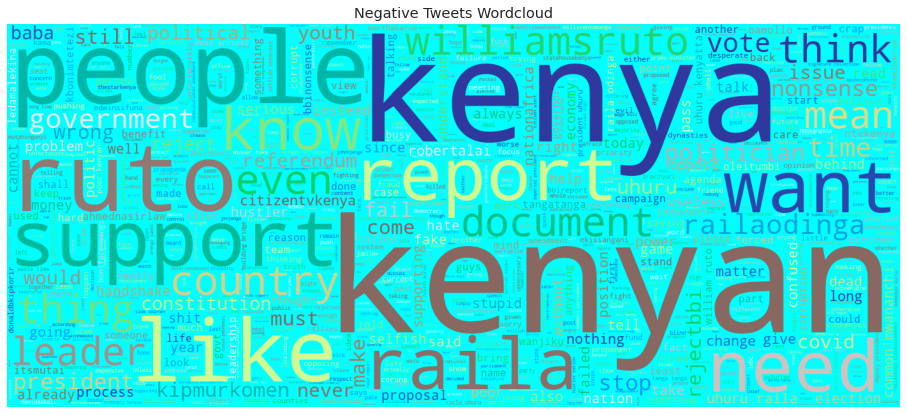

In [57]:
#Negative Tweets 

wc = WordCloud(height=600,repeat=False,width=1400,max_words=1000,stopwords=stop,colormap='terrain',
               background_color='Cyan',mode='RGBA').generate(' '.join(negative_tweets['tweet'].dropna().astype(str)))
plt.figure(figsize = (16,16))
plt.imshow(wc)
plt.title('Negative Tweets Wordcloud')
plt.axis('off')
plt.show()

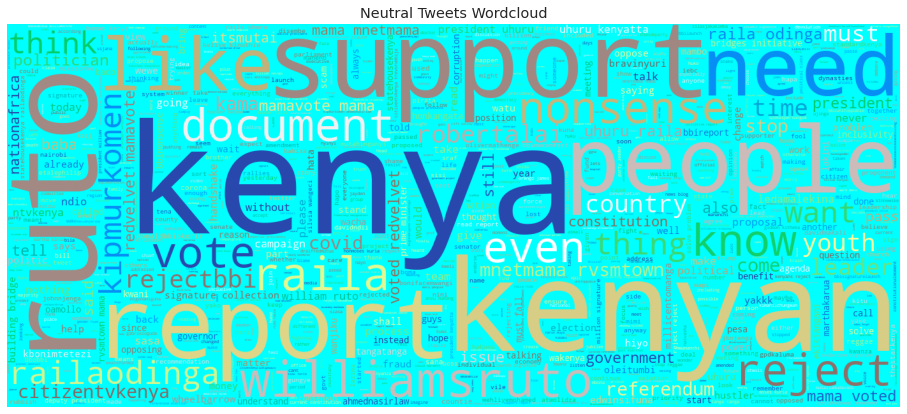

In [59]:
#Neutral Tweets 

wc = WordCloud(height=600,repeat=False,width=1400,max_words=1000,stopwords=stop,colormap='terrain',
               background_color='Cyan',mode='RGBA').generate(' '.join(neutral_tweets['tweet'].dropna().astype(str)))
plt.figure(figsize = (16,16))
plt.imshow(wc)
plt.title('Neutral Tweets Wordcloud')
plt.axis('off')
plt.show()

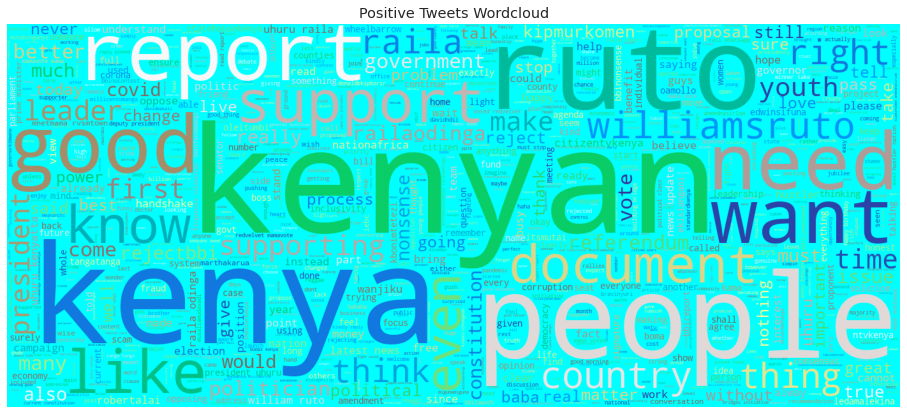

In [60]:
#Negative Tweets 

wc = WordCloud(height=600,repeat=False,width=1400,max_words=1000,stopwords=stop,colormap='terrain',
               background_color='Cyan',mode='RGBA').generate(' '.join(positive_tweets['tweet'].dropna().astype(str)))
plt.figure(figsize = (16,16))
plt.imshow(wc)
plt.title('Positive Tweets Wordcloud')
plt.axis('off')
plt.show()